## Import packages

In [1]:
import os 
import scanpy as sc
import numpy as np 
from scipy import stats
import seaborn as sns
import matplotlib as mpl
from matplotlib import pyplot as plt 
from PIL import Image
from shapely.geometry import Polygon


import thor
from thor.utils import convert_pixel_to_micron_visium, get_ROI_tuple_from_polygon, get_adata_layer_array
from thor.pl import annotate_ROI, get_nuclei_pixels, single_molecule
from thor.analy import get_pathway_score

In [2]:
%config InlineBackend.figure_format = 'retina'
sc.set_figure_params(dpi=100, color_map="RdYlGn_r", vector_friendly=True, fontsize=18, dpi_save=300, frameon=False, figsize=(5,5))
sc.settings.verbosity = "error"

## Load the image (for visualization) and Thor-predicted cell-level transcriptome result

In [ ]:
adata_path = "processed_data/thor_dcis.h5ad"
ad = sc.read_h5ad(adata_path)
ad

AnnData object with n_obs × n_vars = 76320 × 2748
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'spot_barcodes', 'x', 'y', 'mean_gray', 'std_gray', 'entropy_img', 'mean_r', 'mean_g', 'mean_b', 'std_r', 'std_g', 'std_b', 'spot_heterogeneity', 'node_weights', 'tumor_region', 'tumor_region_ext', 'copy_variation'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'used_for_prediction', 'used_for_reduced', 'used_for_vae'
    uns: 'cell_image_props', 'copy_variation_colors', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'recluster_normal_colors', 'snn', 'spatial', 'tumor_cluster_CNV_colors', 'tumor_normal_subtumor_colors', 'tumor_region_boundaries', 'umap'
    obsm: 'spatial'
    obsp: 'snn_connectivities', 'snn_knn_connectivities', 'snn_transition_matrix'

## Hallmark pathway enrichment

Pathway enrichment analyses are done using decoupler-py.

In [ ]:
import decoupler as dc 

# Load MSigDB. This can take a while depending on the internet connection (normally 1-2 minutes)
msigdb = dc.get_resource('MSigDB')

# Filter by hallmark
msigdb = msigdb[msigdb['collection']=='hallmark']
msigdb = msigdb[~msigdb.duplicated(['geneset', 'genesymbol'])]

acts = get_pathway_score(ad, layer=None, net_df=msigdb)
sc.pp.scale(acts)
acts

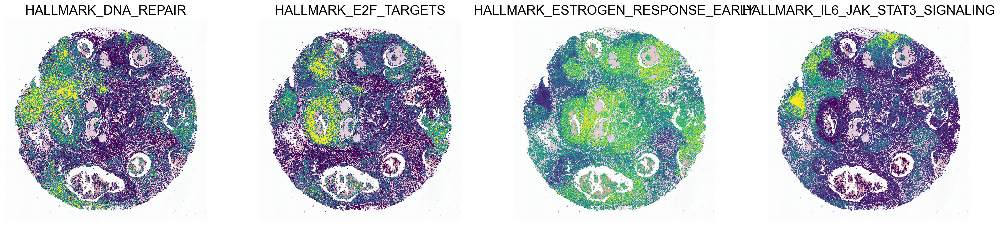

In [16]:
example_pathways = ['HALLMARK_DNA_REPAIR', 'HALLMARK_E2F_TARGETS', 'HALLMARK_ESTROGEN_RESPONSE_EARLY', 'HALLMARK_IL6_JAK_STAT3_SIGNALING']

sc.pl.spatial(acts, color=example_pathways, spot_size=70, cmap='viridis', alpha_img=0.5, ncols=4, vmax='p99', colorbar_loc=None, frameon=False)

## Copy number variation

This requires installation of CopyKAT and R environment in order to run the script. Here we simply show our result.

```from thor.analy import prepare_and_run_copykat```

```prepare_and_run_copykat(adata, datadir, sam_name="BC")```

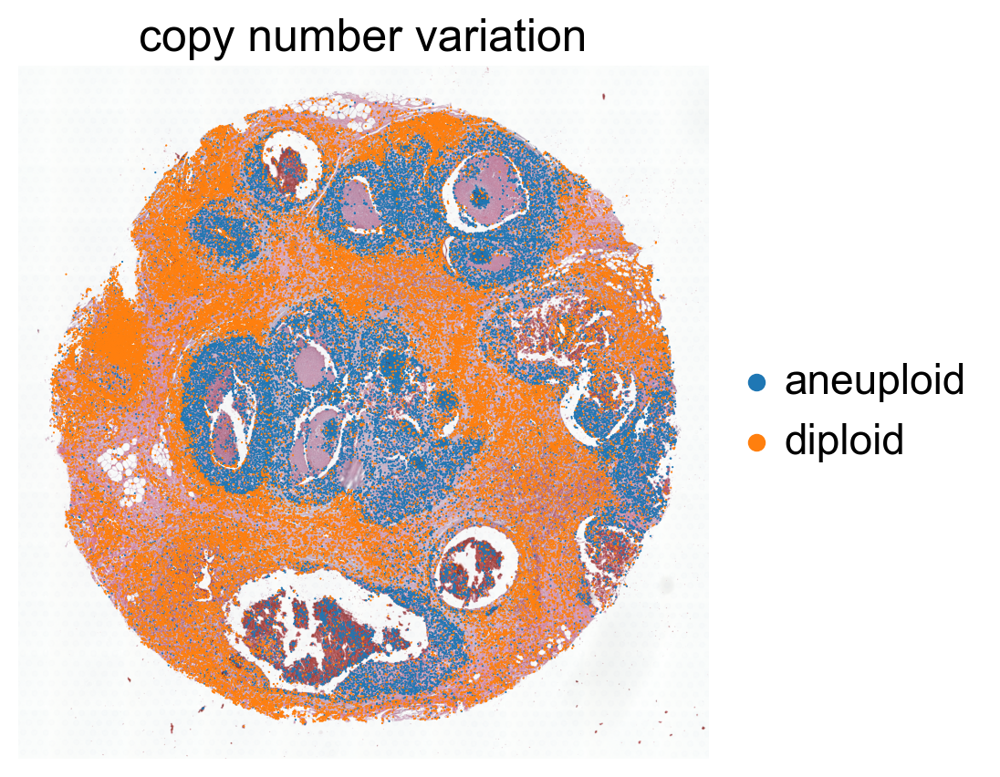

In [6]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(5,5))
sc.pl.spatial(ad, color='copy_variation', title='copy number variation', spot_size=50, vmax=4, cmap='viridis', img_key="hires", show=False, ax=ax, frameon=False)

ax.set_xticks([])
ax.set_yticks([])

plt.show()

In [6]:
ad_spot_cnv = sc.read_h5ad("spot_copykat/BC_copykat_prediction.h5ad")
ad_spot_cnv

AnnData object with n_obs × n_vars = 2518 × 17943
    obs: 'in_tissue', 'array_row', 'array_col', 'copykat_pred'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'copykat_pred_colors', 'spatial'
    obsm: 'spatial'

In [7]:
ad_spot_cnv.obs['copykat_pred']

AAACAAGTATCTCCCA-1      aneuploid
AAACACCAATAACTGC-1        diploid
AAACAGAGCGACTCCT-1        diploid
AAACAGCTTTCAGAAG-1        diploid
AAACAGGGTCTATATT-1        diploid
                         ...     
CGTGACCAGTCCTCTG-1    not.defined
CTTGGCCAAGCTGGGA-1    not.defined
GAAATTGTCTCTATAA-1    not.defined
TATAGAGTCGCTTGAA-1    not.defined
TCCACCTCTAGCCTTT-1    not.defined
Name: copykat_pred, Length: 2518, dtype: category
Categories (3, object): ['aneuploid', 'diploid', 'not.defined']

In [ ]:
import pandas as pd

def majority_variation(s, cut=0.5):
    total = s.sum()

    level_0_index = s.index.get_level_values(0)[0]
    top_idx = (level_0_index, 'aneuploid')
    if s[top_idx] > total * cut:
        return top_idx[1]  # copy_variation
    return "non-aneuploid"

def majority_variation_lenient(s, cut=0.1):
    total = s.sum()

    level_0_index = s.index.get_level_values(0)[0]
    top_idx = (level_0_index, 'aneuploid')
    if s[top_idx] > total * cut:
        return top_idx[1]  # copy_variation
    return "non-aneuploid"
# map cell-level copy number to spot-level based on spot barcode
# if a spot has multiple cells and they have different copy number, we take one with more than 50% of cells

ad_spot_cnv.obs['copy_variation_thor'] = "non-aneuploid"
ad_7 = ad[ad.obs['tumor_region'].isin(['7'])]
ad_not7 = ad[~ad.obs['tumor_region'].isin(['7'])]
cnv_in_spot = ad_not7.obs.groupby(["spot_barcodes"])["copy_variation"].value_counts()
res = cnv_in_spot.groupby(level=0).apply(majority_variation)
common_spots = ad_spot_cnv[ad_spot_cnv.obs.index.isin(res.index)]
ad_spot_cnv.obs.loc[common_spots.obs.index, 'copy_variation_thor'] = res[common_spots.obs.index]

cnv_in_spot = ad_7.obs.groupby(["spot_barcodes"])["copy_variation"].value_counts()
res = cnv_in_spot.groupby(level=0).apply(majority_variation_lenient)
common_spots = ad_spot_cnv[ad_spot_cnv.obs.index.isin(res.index)]
ad_spot_cnv.obs.loc[common_spots.obs.index, 'copy_variation_thor'] = res[common_spots.obs.index]


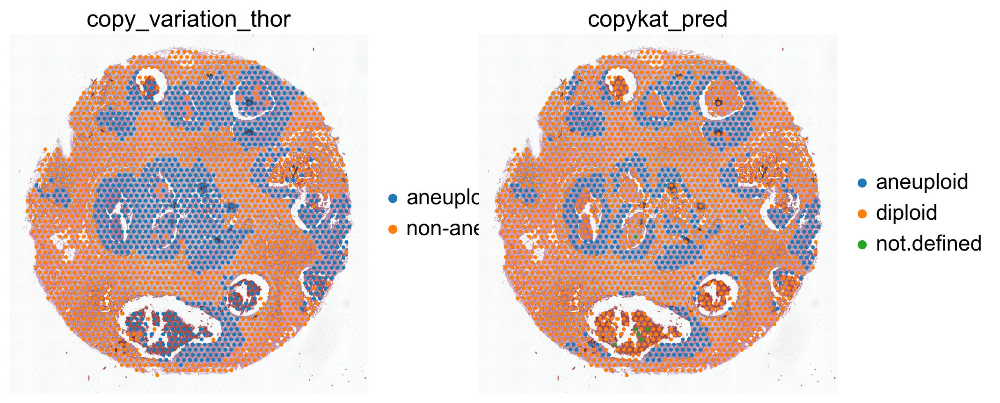

In [ ]:
sc.pl.spatial(ad_spot_cnv, color=["copy_variation_thor", "copykat_pred"], size=1)

In [194]:
from shapely.geometry import Polygon, Point
tumor_regions = ad.uns['tumor_region_boundaries']

# assign each spot to a tumor region

ad_spot_cnv.obs['tumor_region'] = '0'
for i, region in tumor_regions.items():
    for spot in ad_spot_cnv.obs.index:
        if Polygon(region).contains(Point(ad_spot_cnv[spot].obsm['spatial'][:,0], ad_spot_cnv[spot].obsm['spatial'][:,1])):
            ad_spot_cnv.obs['tumor_region'][spot] = i

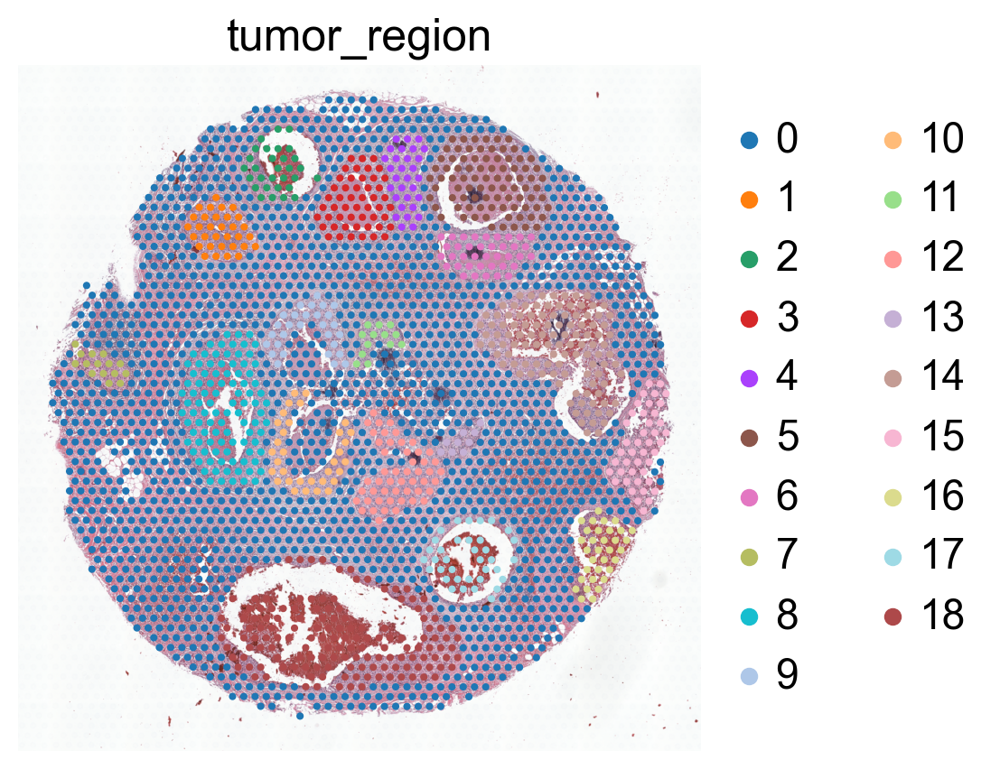

In [261]:
sc.pl.spatial(ad_spot_cnv, color='tumor_region', size=1, cmap='tab20', ncols=1, frameon=False)

In [ ]:
# calculate the F1 score of aneuploid cells in the tumor region

from sklearn.metrics import f1_score, accuracy_score, recall_score, precision_score, jaccard_score, cohen_kappa_score
y_true = ~ad_spot_cnv.obs['tumor_region'].isin(['0'])
y_pred = ad_spot_cnv.obs['copykat_pred'].isin(['aneuploid'])
f1 = f1_score(y_true, y_pred, average='binary')
jaccard = jaccard_score(y_true, y_pred, average='binary')
cohen_kappa = cohen_kappa_score(y_true, y_pred)

print(f"F1 score: {f1:.4f}")
print(f"Jaccard index: {jaccard:.4f}")
print(f"Cohen's kappa: {cohen_kappa:.4f}")

F1 score: 0.7315
Accuracy: 0.8455
Recall: 0.6030
Precision: 0.9298
Jaccard index: 0.5767
Cohen's kappa: 0.6299


In [ ]:
# calculate the F1 score of aneuploid cells in the tumor region

from sklearn.metrics import f1_score, accuracy_score, recall_score, precision_score, jaccard_score, cohen_kappa_score

y_true = ~ad_spot_cnv.obs['tumor_region'].isin(['0'])
y_pred = ad_spot_cnv.obs['copy_variation_thor'].isin(['aneuploid'])

f1 = f1_score(y_true, y_pred, average='binary')
accuracy = accuracy_score(y_true, y_pred)
recall = recall_score(y_true, y_pred, average='binary')
precision = precision_score(y_true, y_pred, average='binary')
jaccard = jaccard_score(y_true, y_pred, average='binary')
cohen_kappa = cohen_kappa_score(y_true, y_pred)

print(f"F1 score: {f1:.4f}")
print(f"Jaccard index: {jaccard:.4f}")
print(f"Cohen's kappa: {cohen_kappa:.4f}")

F1 score: 0.7782
Accuracy: 0.8352
Recall: 0.8282
Precision: 0.7339
Jaccard index: 0.6369
Cohen's kappa: 0.6478


## Tertiary Lymphoid Structures(TLS) score
We use the list of 29 signature genes used by [this study](https://www.ncbi.nlm.nih.gov/pubmed/35231421).

In [8]:
# This is the gene list for the TLS score that we finally used, since it includes more related cell-type markers.
TLS_list_immunity = ['IGHA1',
                    'IGHG1',
                    'IGHG2',
                    'IGHG3',
                    'IGHG4',
                    'IGHGP',
                    'IGHM',
                    'IGKC',
                    'IGLC1',
                    'IGLC2',
                    'IGLC3',
                    'JCHAIN',
                    'CD79A',
                    'FCRL5',
                    'MZB1',
                    'SSR4',
                    'XBP1',
                    'TRBC2',
                    'IL7R',
                    'CXCL12',
                    'LUM',
                    'C1QA',
                    'C7',
                    'CD52',
                    'APOE',
                    'PLTP',
                    'PTGDS',
                    'PIM2',
                    'DERL3']

sc.tl.score_genes(ad, TLS_list_immunity, ctrl_size=len(TLS_list_immunity), gene_pool=None, n_bins=25, score_name='TLS_score_immunity', random_state=0, copy=False, use_raw=False)

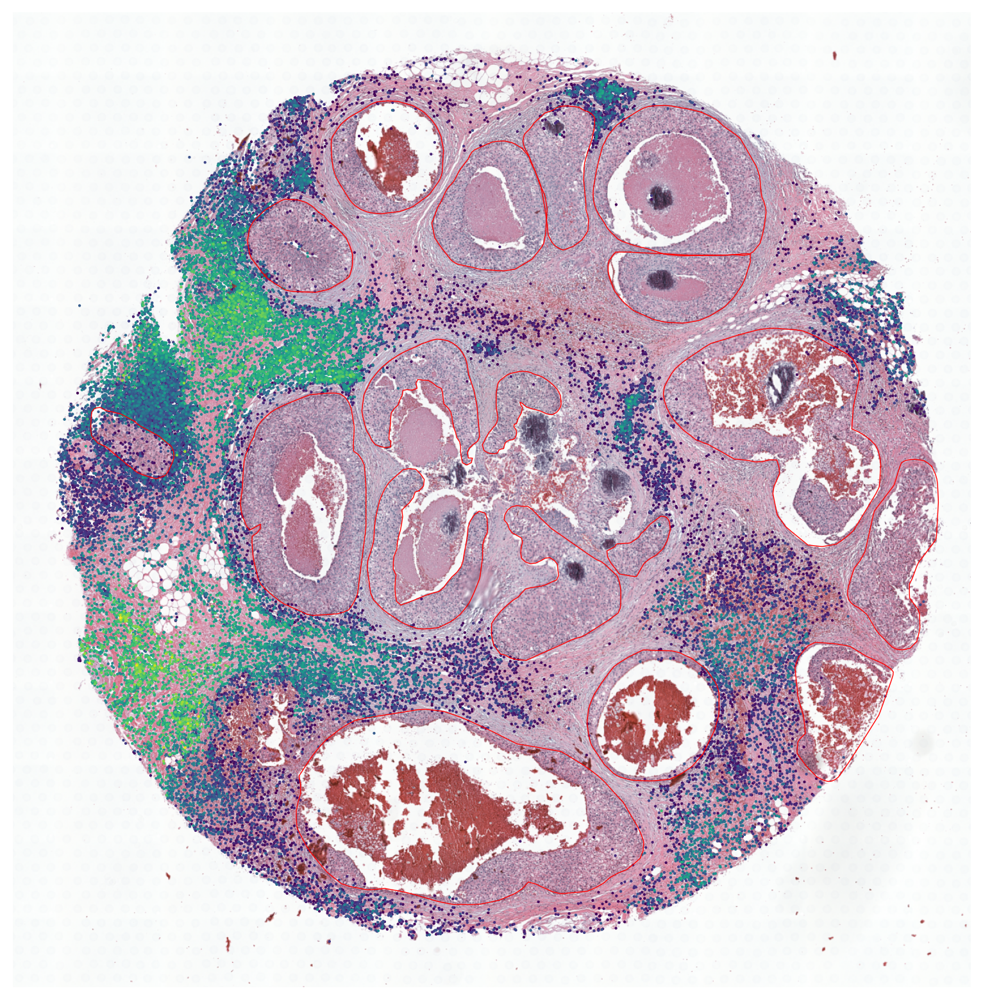

In [9]:
score = 'TLS_score_immunity'
ad1 = ad[ad.obs[score]>0.3]

scalefactor = ad.uns['spatial']['Visium_FFPE_Human_Breast_Cancer']['scalefactors']['tissue_hires_scalef']

fig, ax = plt.subplots(figsize=(10,10))

sc.pl.spatial(ad1, color=score, spot_size=50, cmap='viridis', ncols=1, ax=ax, show=False, title="", colorbar_loc=None)

tumor_borders = ad.uns['tumor_region_boundaries']
for name, border in tumor_borders.items():
    ax.plot(border[:,0]*scalefactor, border[:,1]*scalefactor, color='r', lw=0.5, zorder=3)


plt.show()


Rank the tumor regions according to the TLS score. We extended the tumor regions by 1 spot (55 um) outwards.

In [10]:
region_col = 'tumor_region_ext'
scores =  ['TLS_score_immunity']

for score in scores:
    ad1 = ad[ad.obs[score]>0.]
    TLS_clone_stats1 = ad1.obs.groupby(region_col)[[score]].aggregate('median')
    rank = list(np.array(TLS_clone_stats1.sort_values(by=score, ascending=False).index))
    rank.remove('0')

    print(rank)


['7', '1', '17', '16', '4', '8', '5', '12', '9', '18', '2', '14', '10', '3', '13', '11', '6', '15']


In [11]:
ad

AnnData object with n_obs × n_vars = 76320 × 2748
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'spot_barcodes', 'x', 'y', 'mean_gray', 'std_gray', 'entropy_img', 'mean_r', 'mean_g', 'mean_b', 'std_r', 'std_g', 'std_b', 'spot_heterogeneity', 'node_weights', 'tumor_region', 'tumor_region_ext', 'copy_variation', 'TLS_score_immunity'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'used_for_prediction', 'used_for_reduced', 'used_for_vae'
    uns: 'cell_image_props', 'copy_variation_colors', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'recluster_normal_colors', 'snn', 'spatial', 'tumor_cluster_CNV_colors', 'tumor_normal_subtumor_colors', 'tumor_region_boundaries', 'umap'
    obsm: 'spatial'
    obsp: 'snn_connectivities', 'snn_knn_connectivities', 'snn_transition_matrix'

Text(0, 0.5, 'TLS score')

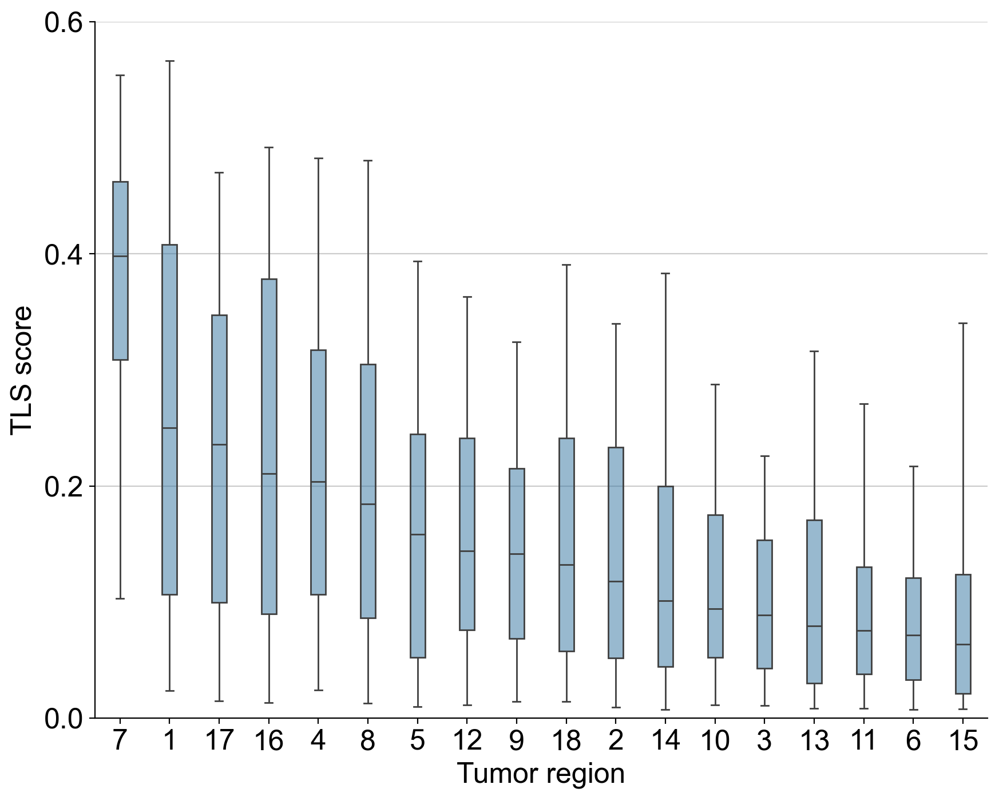

In [12]:
import seaborn as sns
from matplotlib import pyplot as plt

tumor_col = 'tumor_region_ext'
score = 'TLS_score_immunity'

df = ad.obs[[region_col, score]]
df = df.loc[df[score]>0, :]
df = df.loc[df[region_col]!='0', :]

fig, ax = plt.subplots(figsize=(10, 8))

ax.spines.right.set_color('none')
ax.spines.top.set_color('none')
ax = sns.boxplot(df, y=score, x=region_col, whis=[5,95], dodge=False, width=0.3, fliersize=0., order=rank )
for patch in ax.patches:
    r, g, b, a = patch.get_facecolor()
    patch.set_facecolor((r, g, b, .5))
ax._remove_legend(ax.get_legend())
ax.set_ylim(0,0.6)
ax.set_yticks([0, 0.2, 0.4, 0.6])
ax.set_xlabel('Tumor region')
ax.set_ylabel('TLS score')

### Spot level TLS score

In [212]:
sc.tl.score_genes(ad_spot, TLS_list_immunity, ctrl_size=len(TLS_list_immunity), gene_pool=None, n_bins=25, score_name='TLS_score_immunity', random_state=0, copy=False, use_raw=False)

In [222]:
from thor.utils import get_spot_diameter_in_pixels

buffer_size = get_spot_diameter_in_pixels(ad_spot)

In [266]:
from shapely.geometry import Polygon, Point
tumor_regions = ad.uns['tumor_region_boundaries']

# assign each spot to a tumor region
ad_spot.obs['tumor_region_ext'] = '0'
for i, region in tumor_regions.items():
    poly = Polygon(region)
    buffer = poly.buffer(buffer_size*3)
    #buffer = buffer - poly
    for spot in ad_spot.obs.index:
        if buffer.contains(Point(ad_spot[spot].obsm['spatial'][:,0], ad_spot[spot].obsm['spatial'][:,1])):
            ad_spot.obs['tumor_region_ext'][spot] = i

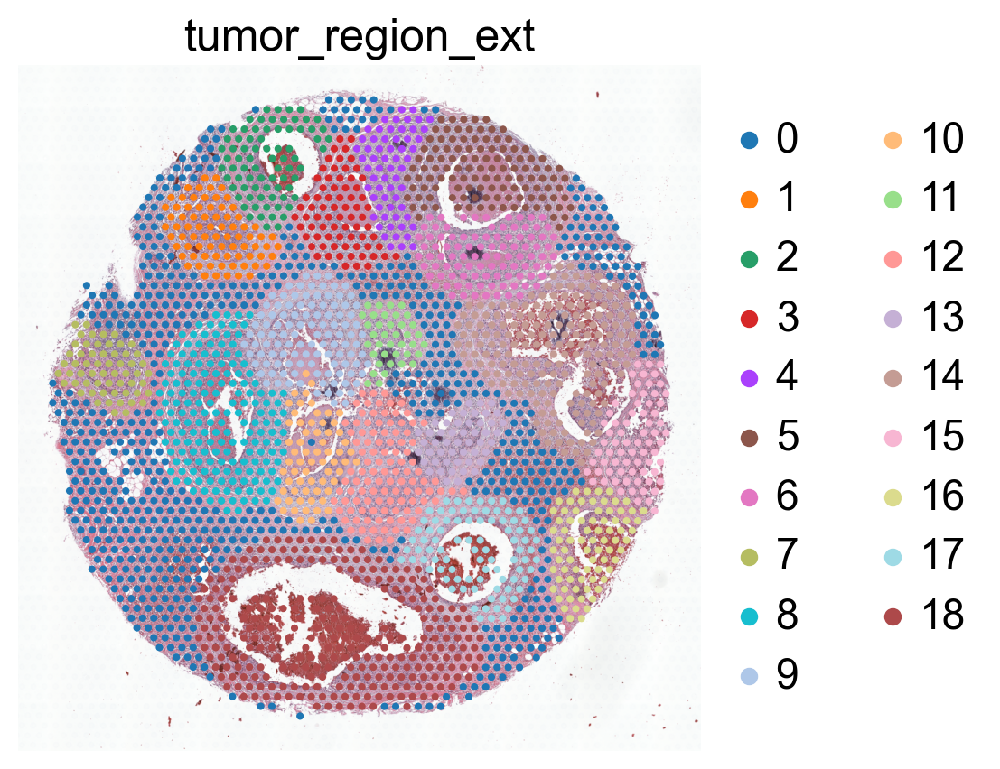

In [269]:
sc.pl.spatial(ad_spot, color='tumor_region_ext', size=1, cmap='tab20', ncols=1, frameon=False)

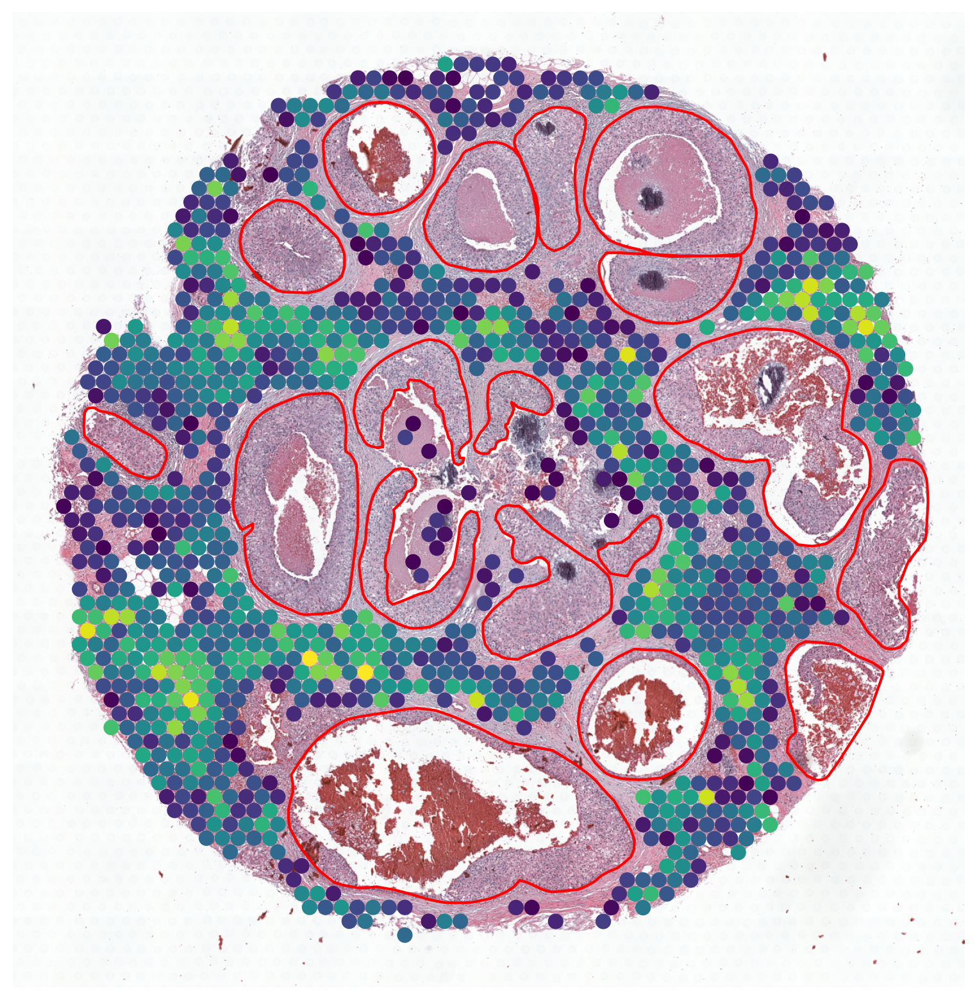

In [263]:
score = 'TLS_score_immunity'

ad1.obs['tumor_region'] = ad_spot_cnv.obs.loc[ad_spot_cnv.obs.index, 'tumor_region']
ad1 = ad_spot[ad_spot.obs[score]>0.3]
ad1 = ad1[ad1.obs['tumor_region']=='0']

scalefactor = ad_spot.uns['spatial']['Visium_FFPE_Human_Breast_Cancer']['scalefactors']['tissue_hires_scalef']

fig, ax = plt.subplots(figsize=(10,10))

sc.pl.spatial(ad1, color=score, size=1.5, cmap='viridis', ncols=1, ax=ax, show=False, title="", colorbar_loc=None)

tumor_borders = ad.uns['tumor_region_boundaries']
for name, border in tumor_borders.items():
    ax.plot(border[:,0]*scalefactor, border[:,1]*scalefactor, color='r', lw=1.5, zorder=3)


plt.show()


In [268]:
region_col = 'tumor_region'
scores =  ['TLS_score_immunity']

for score in scores:
    ad1 = ad_spot[ad_spot.obs[score]>0.]
    TLS_clone_stats1 = ad1.obs.groupby(region_col)[[score]].aggregate('median')
    rank = list(np.array(TLS_clone_stats1.sort_values(by=score, ascending=False).index))
    rank.remove('0')

    print(rank)

['7', '4', '17', '18', '14', '10', '2', '3', '13', '16', '8', '15', '1', '6', '12', '5', '9', '11']


Text(0, 0.5, 'TLS score')

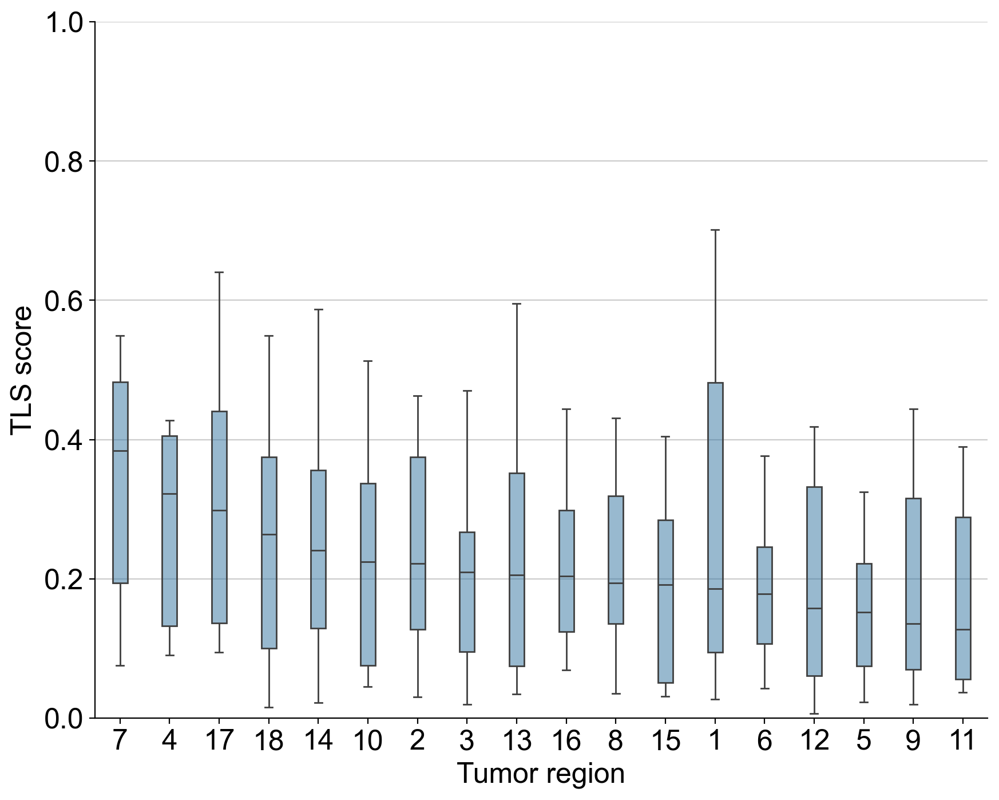

In [270]:
import seaborn as sns
from matplotlib import pyplot as plt

tumor_col = 'tumor_region_ext'
score = 'TLS_score_immunity'

df = ad_spot.obs[[region_col, score]]
df = df.loc[df[score]>=0, :]
df = df.loc[df[region_col]!='0', :]

fig, ax = plt.subplots(figsize=(10, 8))

ax.spines.right.set_color('none')
ax.spines.top.set_color('none')
ax = sns.boxplot(df, y=score, x=region_col, whis=[5,95], dodge=False, width=0.3, fliersize=0., order=rank )
for patch in ax.patches:
    r, g, b, a = patch.get_facecolor()
    patch.set_facecolor((r, g, b, .5))
#sns.stripplot(df, y=score, x=region_col, ax=ax, size=0.8, jitter=0.05, dodge=True, legend="", alpha=1)
ax._remove_legend(ax.get_legend())
ax.set_ylim(0,0.6)
ax.set_yticks([0, 0.2, 0.4, 0.6, 0.8, 1])
ax.set_xlabel('Tumor region')
ax.set_ylabel('TLS score')